<a href="https://colab.research.google.com/github/mouadh-belalmi/PCB_detection/blob/main/pcb_defect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Importing the standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import patches
import seaborn as sns
import os
import random
import re
import shutil
sns.set_style('darkgrid')
sns.set_palette('pastel')

import warnings
warnings.filterwarnings('ignore')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Defining the input
input_dir = '/content/drive/MyDrive/PCB_DATASET'
os.listdir(input_dir)

['rotate.py', 'images', 'Annotations', 'PCB_USED', 'rotation']

*  **PCB USED folder**- contains the 10 template images we used in the dataset.
* **images folder**- contains the PCB images subclassed into different types.
* **rotation folder**- contains the rotated PCB images subclassed into different types as well as rotation angle
* **annotations folder**- contains the annotations for bounding box of each images





**Analyzing the PCB USED folder**

In [ ]:
template_dir=os.path.join(input_dir,'PCB_USED')
template_dir

'/content/drive/MyDrive/PCB_DATASET/PCB_USED'

In [ ]:
#Creating function to visualize images:
def visualize_img(dir_name,num_images):
    k=1
    plt.figure(figsize=(8,(num_images//2)*6))
    for filename in os.listdir(dir_name)[0:num_images]:
        if filename.lower().endswith(('.jpg','.jpeg','.png')):
            ax=plt.subplot((num_images//2)+1,2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()

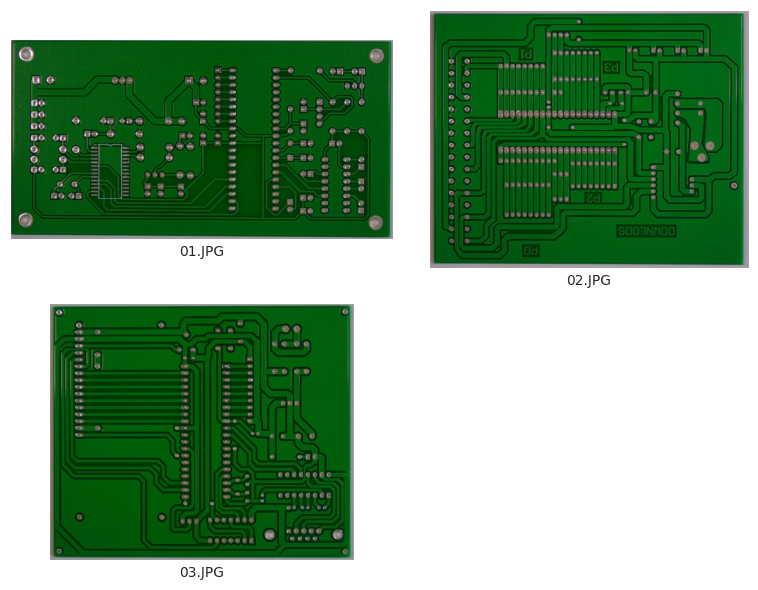

No of template images:10


In [ ]:
visualize_img(template_dir,num_images=3)

print(f'No of template images:{len(os.listdir(template_dir))}')

**Analyzing the images folder**

In [ ]:
#Defining the image directory
img_dir=os.path.join(input_dir,'images')

#Listing the types of defects
os.listdir(img_dir)
types_defect=os.listdir(os.path.join(input_dir,'images'))
types_defect

['Spurious_copper',
 'Short',
 'Spur',
 'Open_circuit',
 'Mouse_bite',
 'Missing_hole']

Create a list containing the full paths to all images in subfolders within **img_dir**

In [ ]:
#Creating an image path list for ready refernce
img_path_list=[]
#Creating img_path list
for sub_cat in types_defect:
    for file in os.listdir(os.path.join(img_dir,sub_cat)):

        img_path_list.append(os.path.join(img_dir,sub_cat,file))


Display samples of defect images for each defect type.\
Count the number of images for each defect type and save them in a DataFrame.

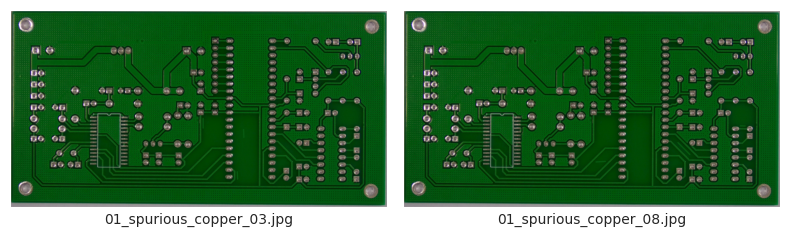

No of Spurious_copper images:116


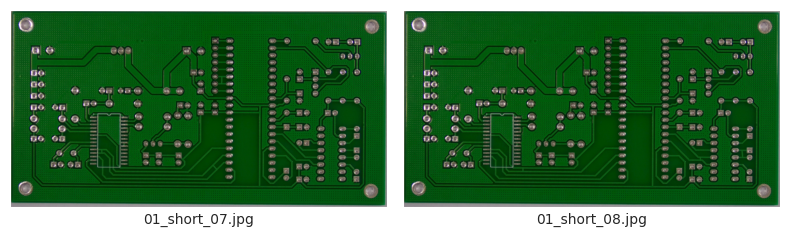

No of Short images:116


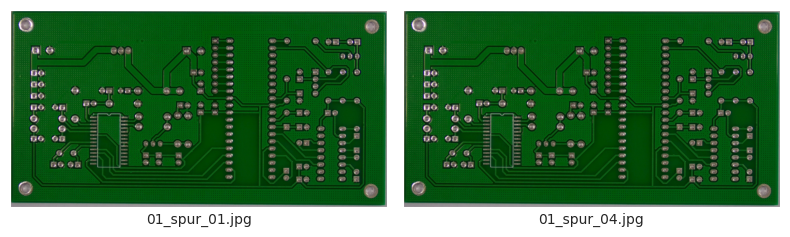

No of Spur images:115


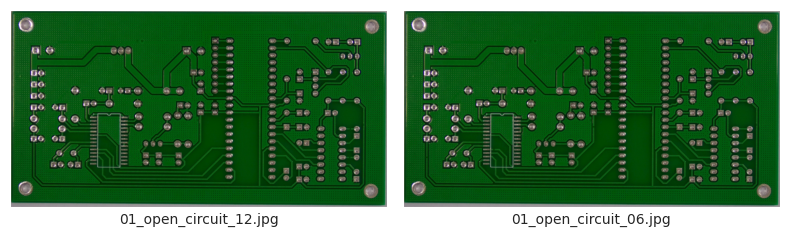

No of Open_circuit images:116


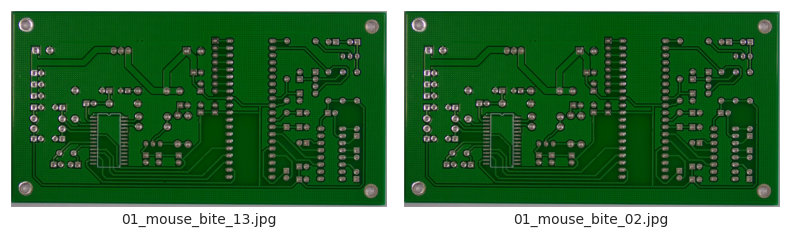

No of Mouse_bite images:115


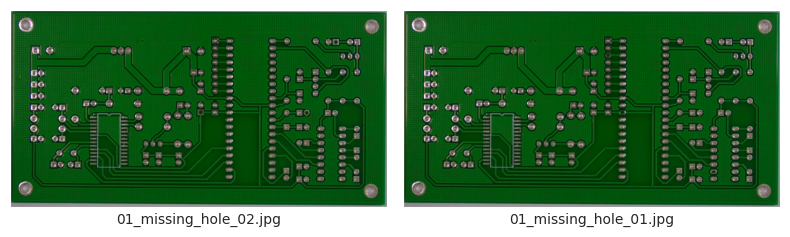

No of Missing_hole images:115


In [ ]:
#Vizualizing defect images for each type
df_defect=pd.DataFrame(columns=['No of defect']) #dataframe for counting no of defects
for sub_cat in types_defect:
    visualize_img(os.path.join(img_dir,sub_cat),num_images=2)  #Visualizing 2 types of defect for each type

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(img_dir,sub_cat)))}')

    df_defect.loc[sub_cat]=len(os.listdir(os.path.join(img_dir,sub_cat)))


In [ ]:
#Display the number of defects for each defect type:
df_defect

,No of defect
Spurious_copper,116
Short,116
Spur,115
Open_circuit,116
Mouse_bite,115
Missing_hole,115


**Analyzing rotated folder**

In [ ]:
rotated_dir=os.path.join(input_dir,'rotation')
os.listdir(rotated_dir)

['Missing_hole_angles.txt',
 'Mouse_bite_angles.txt',
 'Open_circuit_angles.txt',
 'Short_angles.txt',
 'Spur_angles.txt',
 'Spurious_copper_angles.txt',
 'Missing_hole_rotation',
 'Spur_rotation',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Mouse_bite_rotation',
 'Open_circuit_rotation']

In [ ]:
rotated_angle_list=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')]
rotated_angle_list

['Missing_hole_angles.txt',
 'Mouse_bite_angles.txt',
 'Open_circuit_angles.txt',
 'Short_angles.txt',
 'Spur_angles.txt',
 'Spurious_copper_angles.txt']

In [ ]:
types_defect_rotated=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')==False]
types_defect_rotated

['Missing_hole_rotation',
 'Spur_rotation',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Mouse_bite_rotation',
 'Open_circuit_rotation']

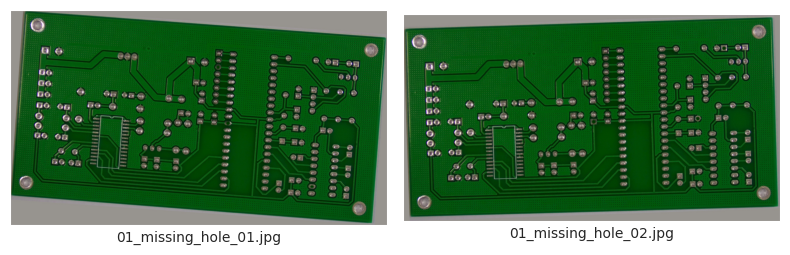

No of Missing_hole_rotation images:115


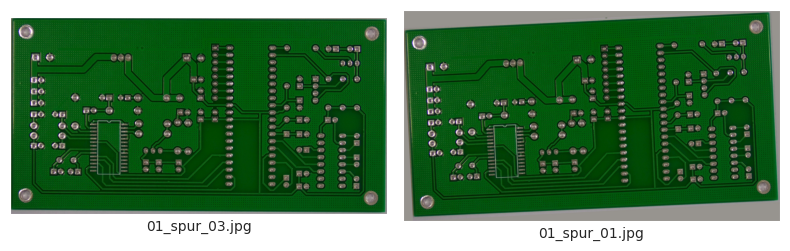

No of Spur_rotation images:115


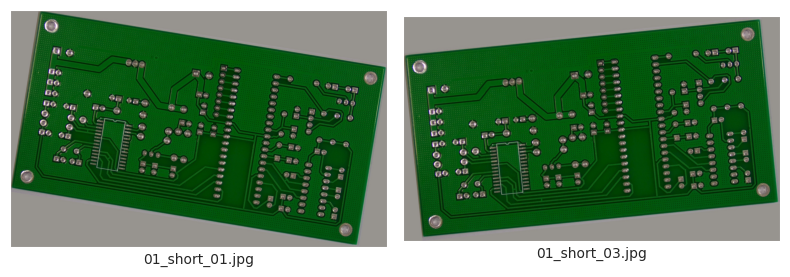

No of Short_rotation images:116


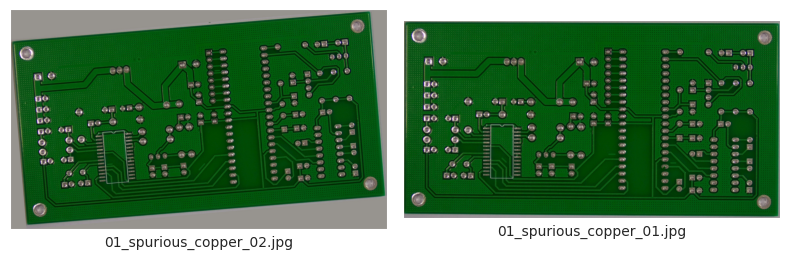

No of Spurious_copper_rotation images:116


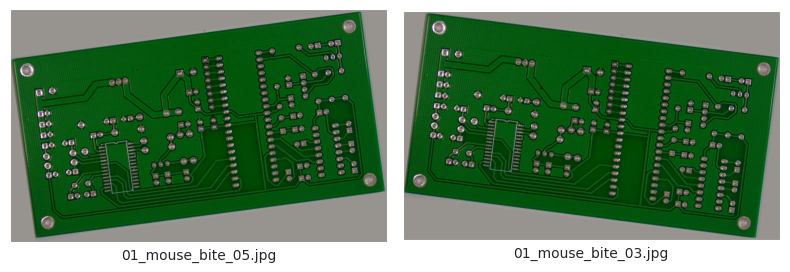

No of Mouse_bite_rotation images:115


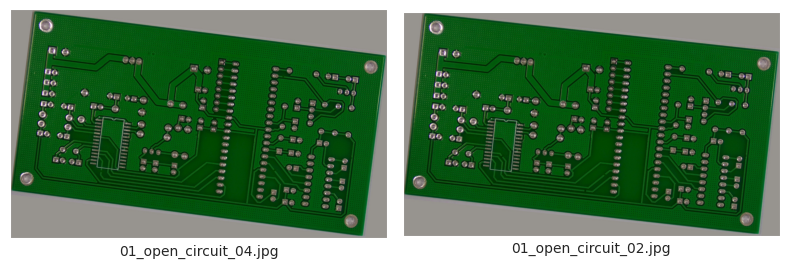

No of Open_circuit_rotation images:116


In [ ]:
#Vizualizing rotated defects
df_defect_rotated=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect_rotated:
    visualize_img(os.path.join(rotated_dir,sub_cat),num_images=2)

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(rotated_dir,sub_cat)))}')

    df_defect_rotated.loc[sub_cat]=len(os.listdir(os.path.join(rotated_dir,sub_cat)))

In [ ]:
#No. of defects by type  rotated
df_defect_rotated

,No of defect
Missing_hole_rotation,115
Spur_rotation,115
Short_rotation,116
Spurious_copper_rotation,116
Mouse_bite_rotation,115
Open_circuit_rotation,116


In [ ]:
#Reading the rotation text files

df_rotation_angle=pd.DataFrame(columns=['Line','Angle'])
for filename in rotated_angle_list:
    with open(os.path.join(rotated_dir,filename),'r') as f:
        lines=f.readlines()
        for line in lines:
            text,angle=line.split()
            df_rotation_angle=pd.concat([df_rotation_angle,pd.DataFrame({'Line':[text],'Angle':[angle]})],axis=0)


In [ ]:
df_rotation_angle

,Line,Angle
0,08_missing_hole_03,-9
0,05_missing_hole_01,8
0,08_missing_hole_04,2
0,05_missing_hole_10,-10
0,01_missing_hole_13,7
...,...,...
0,12_spurious_copper_04,0
0,06_spurious_copper_09,0
0,01_spurious_copper_02,-5
0,12_spurious_copper_05,-1


**Analyzing the annotate folder**

In [ ]:
annote_dir=os.path.join(input_dir,'Annotations')
annote_dir

'/content/drive/MyDrive/PCB_DATASET/Annotations'

In [ ]:
type_annot=os.listdir(annote_dir)
type_annot

['Spurious_copper',
 'Missing_hole',
 'Mouse_bite',
 'Spur',
 'Short',
 'Open_circuit']

In [ ]:
df_annot_nos=pd.DataFrame(columns=['No of annotations'])
#Checking the length of annotation itms
for i in type_annot:
    df_annot_nos.loc[i]=len(os.listdir(os.path.join(annote_dir,i)))
df_annot_nos

,No of annotations
Spurious_copper,116
Missing_hole,115
Mouse_bite,115
Spur,115
Short,116
Open_circuit,116


We see that we have an annotation file for each image

In [ ]:
#Checking the type of files
file_list=os.listdir(os.path.join(annote_dir,'Mouse_bite'))
file_list[0:5]

['08_mouse_bite_01.xml',
 '08_mouse_bite_03.xml',
 '12_mouse_bite_08.xml',
 '04_mouse_bite_11.xml',
 '12_mouse_bite_10.xml']

We see that all files are in XML format, so we have to parse the data

In [ ]:
#importing xml ET to parse xml file
import xml.etree.ElementTree as ET



In [ ]:
tree = ET.parse(os.path.join(os.path.join(annote_dir,'Mouse_bite'),'01_mouse_bite_11.xml'))
root = tree.getroot()

In [ ]:
#getting the structure of XML file
print(ET.tostring(root, encoding='utf8').decode('utf8'))

<?xml version='1.0' encoding='utf8'?>
<annotation>
	<folder>Mouse_bite</folder>
	<filename>01_mouse_bite_11.jpg</filename>
	<path>/home/weapon/Desktop/PCB_DATASET/Mouse_bite/01_mouse_bite_11.jpg</path>
	<source>
		<database>Unknown</database>
	</source>
	<size>
		<width>3034</width>
		<height>1586</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1199</xmin>
			<ymin>966</ymin>
			<xmax>1234</xmax>
			<ymax>1004</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>2042</xmin>
			<ymin>755</ymin>
			<xmax>2073</xmax>
			<ymax>786</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1472</xmin>
			<ymin>607</ymin>
		

In [ ]:
#Parsing XML to return Bounding box dimensions
def parse_xml(xml_file):

    data=[]

    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    width = int(root.find('size/width').text)
    height = int(root.find('size/height').text)
    for obj in root.findall('object'):
        name = obj.find('name').text
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)

        data.append({
            'filename': filename,
            'width': width,
            'height': height,
            'class': name,
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        })

    return data

In [ ]:
#Retrieving data for all files
data=[]
all_data=[]

for x in type_annot:
    for file in os.listdir(os.path.join(annote_dir,x)):
        xml_file_path=os.path.join(os.path.join(annote_dir,x),file)
        data=parse_xml(xml_file_path)
        all_data.extend(data)


In [ ]:
#Creating a dataframe to store the annotations
df_annot=pd.DataFrame(all_data)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,07_spurious_copper_01.jpg,2904,1921,spurious_copper,975,244,1108,298
1,07_spurious_copper_01.jpg,2904,1921,spurious_copper,930,988,1086,1041
2,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1451,879,1513,984
3,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1591,819,1639,920
4,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1856,1001,1975,1046
...,...,...,...,...,...,...,...,...
2948,10_open_circuit_03.jpg,2240,2016,open_circuit,1865,735,1956,796
2949,10_open_circuit_03.jpg,2240,2016,open_circuit,1245,445,1325,519
2950,04_open_circuit_10.jpg,3056,2464,open_circuit,1171,1708,1241,1753
2951,04_open_circuit_10.jpg,3056,2464,open_circuit,2181,1466,2235,1535


Text(0.5, 0, 'No of defects in one PCB')

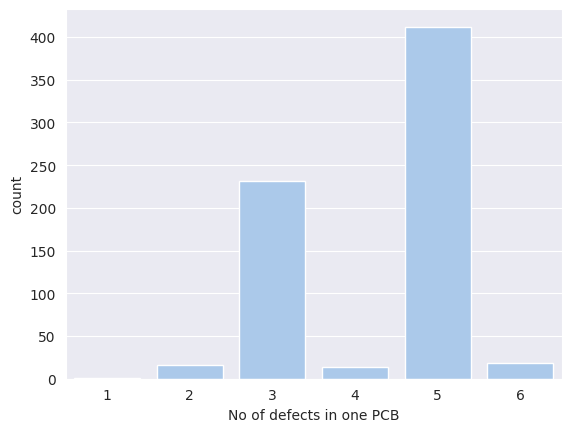

In [ ]:
#Visualizing the no of defects in each pcb
df_multiple_defects=pd.DataFrame(df_annot['filename'].value_counts())
sns.countplot(df_multiple_defects,x='count')
plt.xlabel('No of defects in one PCB')

There are 1-6 no. of defects in same PCB, with most cases bein 3 or 5

In [ ]:
#Defin|g a function to view image along with bounding box

def draw_bounding_boxes(image_path, bounding_boxes,annotation):

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(15,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box
    for bbox in bounding_boxes:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')


    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])

In [ ]:
#Getting filename from filepath
filepath=img_path_list[0]
filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
filename

'01_spurious_copper_03.jpg'

In [ ]:
#Defining function to select the a file and return image along with bounding box
def visualize_annotations(list_image_path,df):
    for i in list_image_path:
        filepath=i
        filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
        df_selected=df[df['filename']==filename]
        width=df_selected['width'].values
        height=df_selected['height'].values
        class_name=df_selected['class'].values
        xmin=df_selected['xmin'].values
        ymin=df_selected['ymin'].values
        xmax=df_selected['xmax'].values
        ymax=df_selected['ymax'].values

        bbox=zip(xmin,ymin,xmax,ymax)
        draw_bounding_boxes(filepath, bbox,class_name[0])

        # Show the plot
        plt.show()

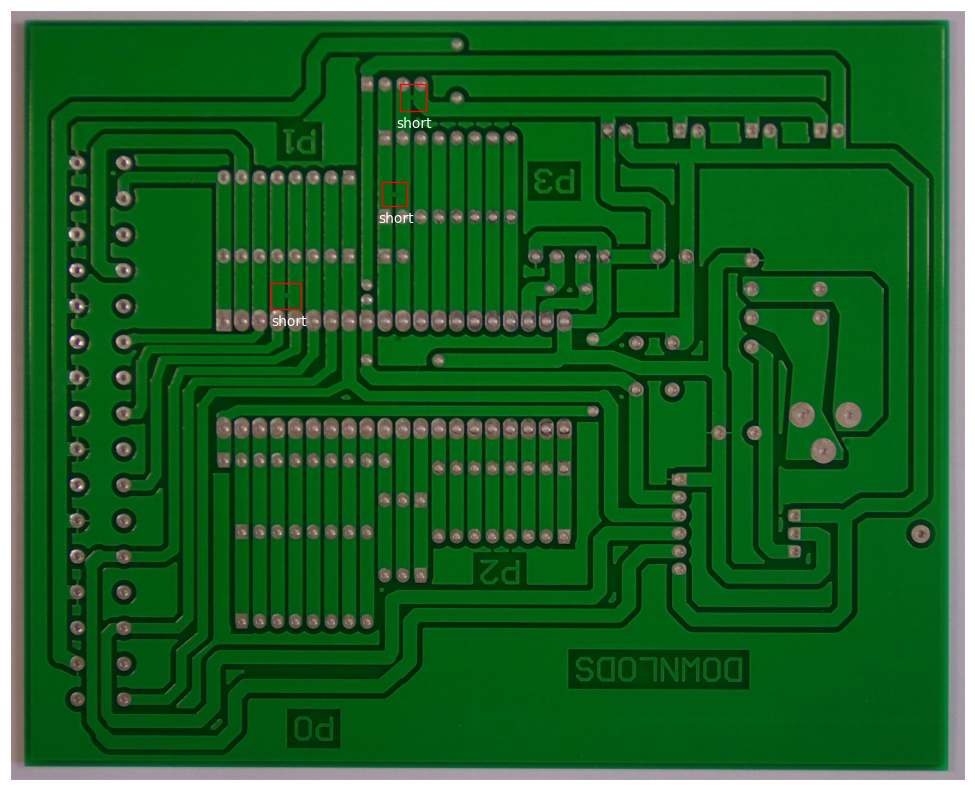

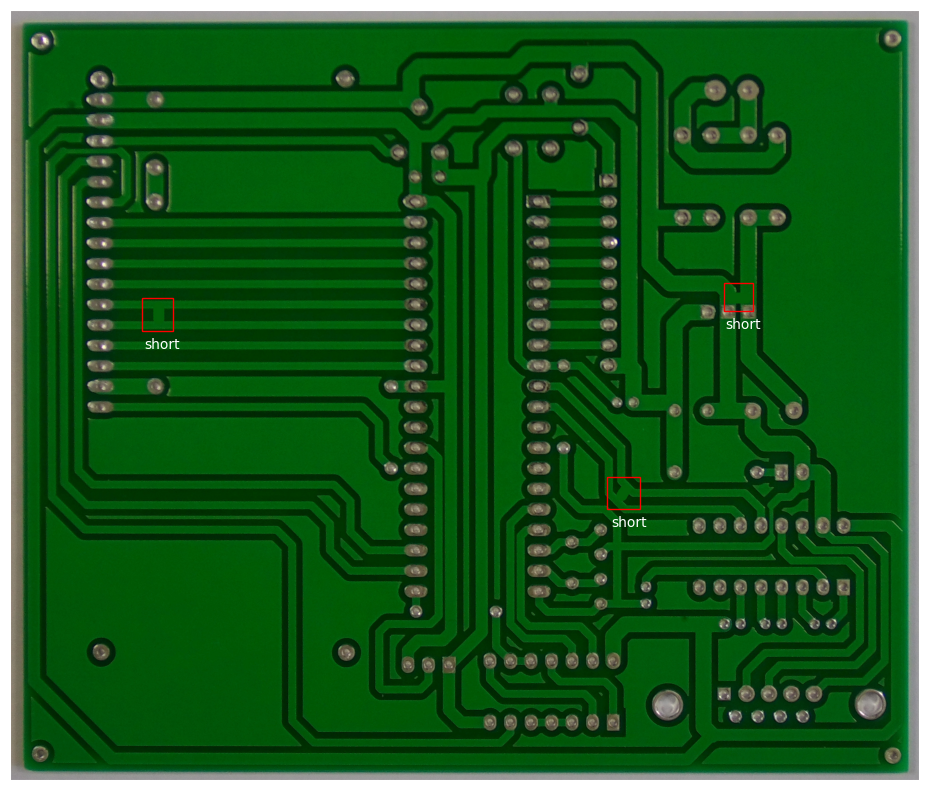

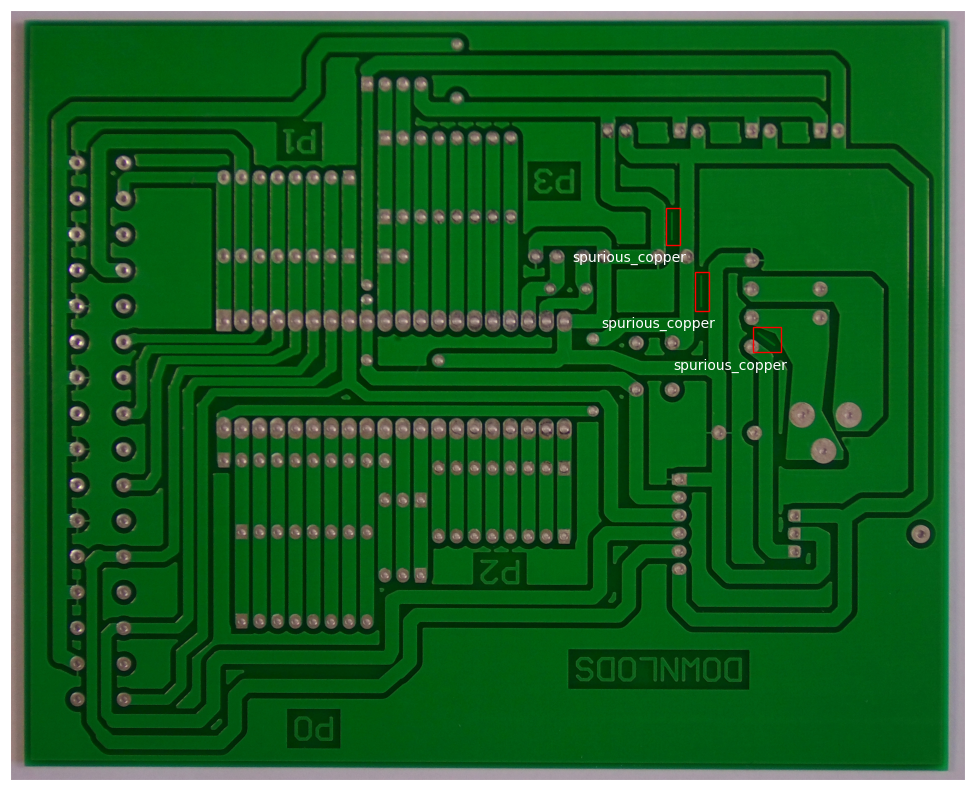

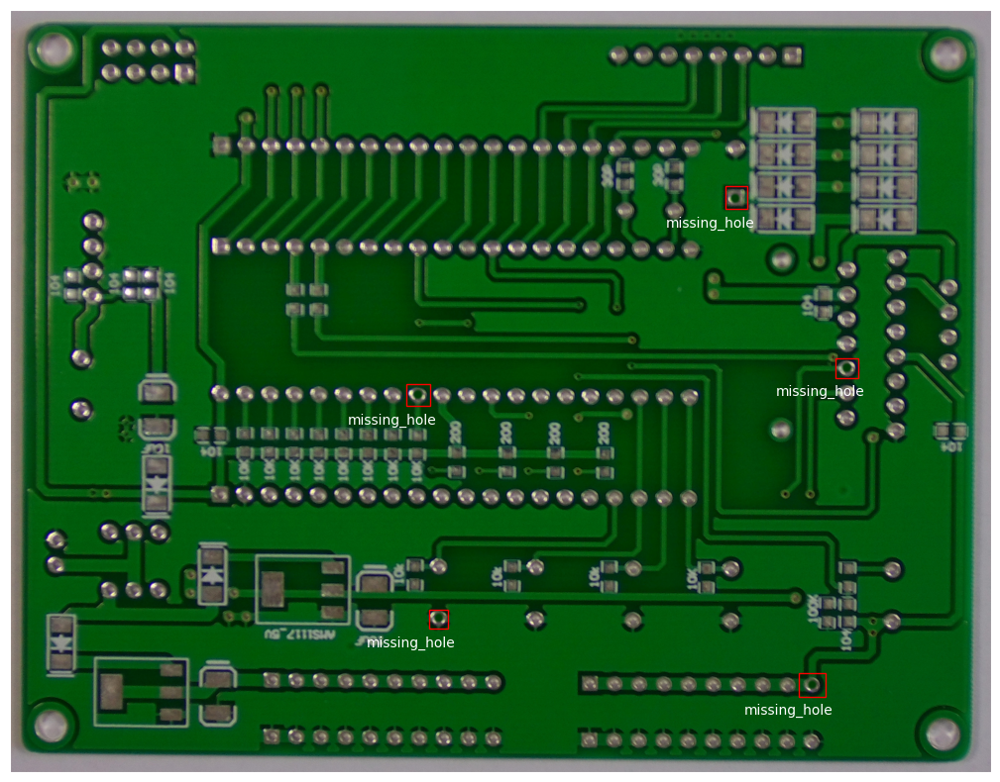

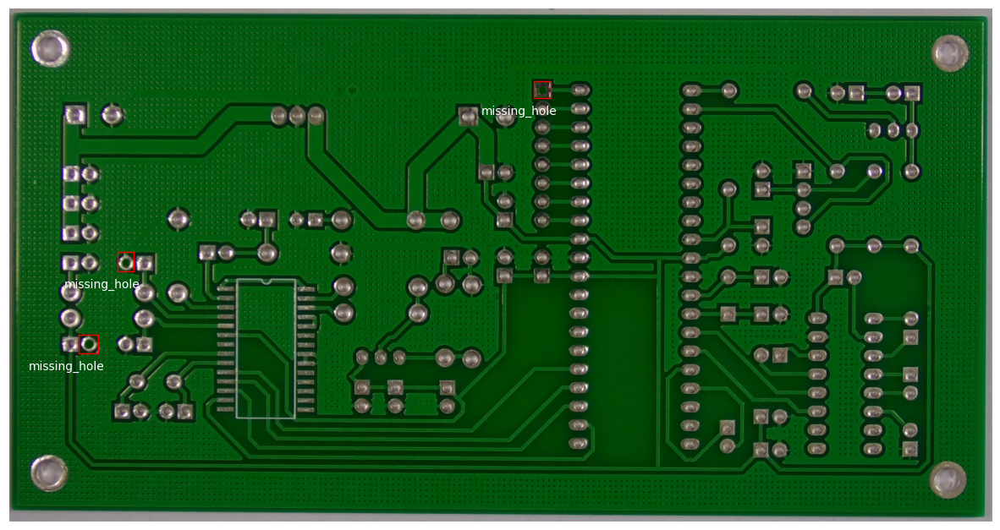

In [ ]:
image_path_shuffle=img_path_list
random.shuffle(image_path_shuffle)

visualize_annotations(image_path_shuffle[0:5],df_annot)

# **Preparing data for inputting to YOLO**



In [ ]:
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,07_spurious_copper_01.jpg,2904,1921,spurious_copper,975,244,1108,298
1,07_spurious_copper_01.jpg,2904,1921,spurious_copper,930,988,1086,1041
2,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1451,879,1513,984
3,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1591,819,1639,920
4,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1856,1001,1975,1046
...,...,...,...,...,...,...,...,...
2948,10_open_circuit_03.jpg,2240,2016,open_circuit,1865,735,1956,796
2949,10_open_circuit_03.jpg,2240,2016,open_circuit,1245,445,1325,519
2950,04_open_circuit_10.jpg,3056,2464,open_circuit,1171,1708,1241,1753
2951,04_open_circuit_10.jpg,3056,2464,open_circuit,2181,1466,2235,1535


We need to create a directory structure with images and annotation as subfolder

In [ ]:
root_dir=os.getcwd()

In [ ]:
#Creating the dataset directory along with images and labels sub-directory
os.makedirs(os.path.join(root_dir,'dataset'),exist_ok=True)
dataset_dir=os.path.join(root_dir,'dataset')

images_dir = os.path.join(dataset_dir, 'images')  #images directory
labels_dir = os.path.join(dataset_dir, 'labels')  #annotations directory
os.makedirs(images_dir,exist_ok=True)
os.makedirs(labels_dir,exist_ok=True)

In [ ]:
os.listdir(dataset_dir)

['images', 'labels']

In [ ]:
#Checking the no of files
len(img_path_list)

693

In [ ]:
#Now splitting our images path list for train,val and test
random.seed(42)
random.shuffle(img_path_list)

train_test_split=0.95
train_val_split=0.8

total_train_len=int(len(img_path_list)*train_test_split)
train_len=int(total_train_len*train_val_split)
val_len=total_train_len-train_len
test_len=len(img_path_list)-train_len-val_len

print(f'Train length:{train_len},Validation length:{val_len},Test length:{test_len}')

Train length:526,Validation length:132,Test length:35


In [ ]:
def path_to_name(filepath):
    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
    return filename

In [ ]:
#Defining a function to copy images from original to target directory
def copy_images_to_dir(original_dir,target_dir,train_len,val_len):

    #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(target_dir,'train')):
        shutil.rmtree(os.path.join(target_dir,'train'))
        shutil.rmtree(os.path.join(target_dir,'val'))
        shutil.rmtree(os.path.join(target_dir,'test'))


    #Making new dircetories within target_dir
    os.makedirs(os.path.join(target_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'test'),exist_ok=True)

    #Copying files
    for filepath in img_path_list[:train_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'train',filename))

    for filepath in img_path_list[train_len:train_len+val_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'val',filename))

    for filepath in img_path_list[train_len+val_len:]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'test',filename))

In [ ]:
copy_images_to_dir(original_dir=input_dir,target_dir=images_dir,train_len=train_len,val_len=val_len)
#Checking the length of files in images dir
print(f"Length of train set:{len(os.listdir(os.path.join(images_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(images_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(images_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


In [ ]:
for set in ['train','val','test']:
    for filename in os.listdir(os.path.join(images_dir,set)):
        for i in df_annot[df_annot['filename']==filename].index:
              df_annot.loc[i,'set']=set
df_annot['set'].value_counts()

,count
set,
train,2229
val,565
test,159


YOLO format should be (class x_center y_center width height)

Class numbers should be zero-indexed (start with 0)

Box coordinates must be in normalized xywh format (from 0 to 1)

In [ ]:
#Defining box dimensions in xywh format [in Normalized format]

df_annot['box_width']=(df_annot['xmax']-df_annot['xmin'])
df_annot['box_height']=(df_annot['ymax']-df_annot['ymin'])

df_annot['x_center']=(df_annot['xmin']+df_annot['box_width']/2)/df_annot['width']
df_annot['y_center']=(df_annot['ymin']+df_annot['box_height']/2)/df_annot['height']

#Normalizing
df_annot['box_width']=df_annot['box_width']/df_annot['width']
df_annot['box_height']=df_annot['box_height']/df_annot['height']
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center
0,07_spurious_copper_01.jpg,2904,1921,spurious_copper,975,244,1108,298,train,0.045799,0.028110,0.358643,0.141072
1,07_spurious_copper_01.jpg,2904,1921,spurious_copper,930,988,1086,1041,train,0.053719,0.027590,0.347107,0.528110
2,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1451,879,1513,984,train,0.021350,0.054659,0.510331,0.484904
3,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1591,819,1639,920,train,0.016529,0.052577,0.556129,0.452629
4,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1856,1001,1975,1046,train,0.040978,0.023425,0.659607,0.532795
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,10_open_circuit_03.jpg,2240,2016,open_circuit,1865,735,1956,796,val,0.040625,0.030258,0.852902,0.379712
2949,10_open_circuit_03.jpg,2240,2016,open_circuit,1245,445,1325,519,val,0.035714,0.036706,0.573661,0.239087
2950,04_open_circuit_10.jpg,3056,2464,open_circuit,1171,1708,1241,1753,train,0.022906,0.018263,0.394634,0.702313
2951,04_open_circuit_10.jpg,3056,2464,open_circuit,2181,1466,2235,1535,train,0.017670,0.028003,0.722513,0.608969


In [ ]:
class_dict=dict(enumerate(df_annot['class'].unique()))
#Preparing the text files
class_dict

{0: 'spurious_copper',
 1: 'missing_hole',
 2: 'mouse_bite',
 3: 'spur',
 4: 'short',
 5: 'open_circuit'}

In [ ]:
reverse_dict={v: k for k, v in class_dict.items()}
df_annot['class_label']=df_annot['class'].map(reverse_dict)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center,class_label
0,07_spurious_copper_01.jpg,2904,1921,spurious_copper,975,244,1108,298,train,0.045799,0.028110,0.358643,0.141072,0
1,07_spurious_copper_01.jpg,2904,1921,spurious_copper,930,988,1086,1041,train,0.053719,0.027590,0.347107,0.528110,0
2,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1451,879,1513,984,train,0.021350,0.054659,0.510331,0.484904,0
3,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1591,819,1639,920,train,0.016529,0.052577,0.556129,0.452629,0
4,07_spurious_copper_01.jpg,2904,1921,spurious_copper,1856,1001,1975,1046,train,0.040978,0.023425,0.659607,0.532795,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,10_open_circuit_03.jpg,2240,2016,open_circuit,1865,735,1956,796,val,0.040625,0.030258,0.852902,0.379712,5
2949,10_open_circuit_03.jpg,2240,2016,open_circuit,1245,445,1325,519,val,0.035714,0.036706,0.573661,0.239087,5
2950,04_open_circuit_10.jpg,3056,2464,open_circuit,1171,1708,1241,1753,train,0.022906,0.018263,0.394634,0.702313,5
2951,04_open_circuit_10.jpg,3056,2464,open_circuit,2181,1466,2235,1535,train,0.017670,0.028003,0.722513,0.608969,5


In [ ]:
#Defining a funation to create labels dir from dataframe

def create_labels_from_df(label_dir,images_dir,df):

     #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(label_dir,'train')):
        shutil.rmtree(os.path.join(label_dir,'train'))
        shutil.rmtree(os.path.join(label_dir,'val'))
        shutil.rmtree(os.path.join(label_dir,'test'))


    #Making new dircetories within label_dir
    os.makedirs(os.path.join(label_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'test'),exist_ok=True)


    #Creating label .txt file in YOLO format
    for i in ['train','test','val']:
        for file_path in os.listdir(os.path.join(images_dir,i)):
            df_temp=df[df['filename']==file_path]
            txt_file_name=".".join([file_path.split('.')[0],'txt'])
            if os.path.exists(os.path.join(label_dir,i,txt_file_name)):
                continue
            else:
                for index, row in df_temp.iterrows():
                    with open(os.path.join(label_dir,i,txt_file_name),'a') as file:
                        file.write(f"{row['class_label']} {row['x_center']} {row['y_center']} {row['box_width']} {row['box_height']}\n" )




In [ ]:
create_labels_from_df(labels_dir,images_dir,df=df_annot)
#Checking the length of files in annotation dir
print(f"Length of train set:{len(os.listdir(os.path.join(labels_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(labels_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(labels_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


# **Preparing Model**

We will use the YOLO model from ultralytics to perform our object detection

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 915.2/915.2 kB 56.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 112.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 79.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 81.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
#Creating YAML format
data_yaml={
    'path':str(os.path.join(root_dir,'dataset')),
    'train':'images/train',
    'val':'images/val',
    'test':'images/test',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_yaml

{'path': '/content/dataset',
 'train': 'images/train',
 'val': 'images/val',
 'test': 'images/test',
 'nc': 6,
 'names': ['spurious_copper',
  'missing_hole',
  'mouse_bite',
  'spur',
  'short',
  'open_circuit']}

In [ ]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

In [ ]:
#Training YOLO model
from ultralytics import YOLO
import ultralytics as ultralytics

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
#Loading model
model=YOLO('yolo11m.pt')

100%|██████████| 38.8M/38.8M [00:00<00:00, 79.6MB/s]


In [ ]:
#Disabling weights & biases metrics
os.environ['WANDB_MODE'] = 'disabled'

In [ ]:
#Training the model
results=model.train(data=os.path.join(root_dir,'data.yaml'),epochs=50)

Ultralytics 8.3.76 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=/content/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, l

100%|██████████| 755k/755k [00:00<00:00, 109MB/s]


Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    111872  ultralytics.nn.modules.block.C3k2            [128, 256, 1, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  1    444928  ultralytics.nn.modules.block.C3k2            [256, 512, 1, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  1   1380352  ultralytics.nn.modules.block.C3k2            [512, 512, 1, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 298MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset/labels/train... 526 images, 0 backgrounds, 0 corrupt: 100%|██████████| 526/526 [00:01<00:00, 281.23it/s]

train: New cache created: /content/dataset/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/labels/val... 132 images, 0 backgrounds, 0 corrupt: 100%|██████████| 132/132 [00:00<00:00, 231.36it/s]

val: New cache created: /content/dataset/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      8.19G      3.142      9.148      1.473         86        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.04it/s]

                   all        132        565      0.288      0.202      0.225     0.0961



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.11G      2.312      2.499      1.059         86        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]


                   all        132        565      0.454      0.426       0.38      0.141

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      8.14G      2.133      1.819      1.022         84        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]


                   all        132        565      0.689      0.665      0.679      0.259

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      8.14G      2.109      1.567      1.007        109        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.73it/s]

                   all        132        565      0.621      0.588      0.554      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      8.14G      1.972      1.333     0.9935         85        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.40it/s]

                   all        132        565       0.82       0.71      0.763      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      8.16G      1.949      1.253     0.9745        105        640: 100%|██████████| 33/33 [00:31<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.73it/s]

                   all        132        565      0.848      0.758        0.8      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      8.15G      1.914      1.205     0.9537         92        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        132        565      0.887      0.744      0.791      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      8.16G      1.907      1.187     0.9572         78        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]


                   all        132        565      0.912      0.806      0.861      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      8.12G      1.869      1.103     0.9628         85        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.33it/s]

                   all        132        565      0.936      0.828      0.886      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      8.12G      1.837      1.056     0.9608         98        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.71it/s]


                   all        132        565       0.89      0.831       0.87      0.414

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      8.14G      1.812      1.062     0.9475        111        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]


                   all        132        565      0.956      0.839      0.894      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      8.16G      1.795      1.026     0.9439         74        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        565      0.927      0.835      0.893      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      8.12G      1.755      1.039      0.944        100        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]

                   all        132        565      0.869      0.732      0.779       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      8.16G      1.753     0.9869     0.9298         79        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]

                   all        132        565      0.884      0.819      0.882      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.15G       1.69     0.9589     0.9229         78        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]


                   all        132        565      0.951      0.863      0.912      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      8.18G      1.694     0.9304     0.9366         91        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]

                   all        132        565      0.905       0.88      0.906      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      8.13G      1.717     0.9347     0.9302         79        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.47it/s]

                   all        132        565      0.947      0.877      0.919      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.13G      1.702     0.9154     0.9258         78        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.52it/s]

                   all        132        565      0.941      0.857      0.909      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      8.17G      1.681     0.8826     0.9259        109        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        132        565      0.956      0.891      0.934      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      8.15G      1.684     0.8988     0.9257         94        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.80it/s]

                   all        132        565      0.951      0.868       0.91      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      8.12G      1.649     0.9032     0.9046         92        640: 100%|██████████| 33/33 [00:33<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]


                   all        132        565      0.929      0.872      0.911      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      8.15G      1.635     0.8617     0.9205        111        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.44it/s]


                   all        132        565      0.943      0.903       0.93      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      8.15G      1.626     0.8501     0.9044        106        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]

                   all        132        565      0.953      0.895      0.927      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      8.18G      1.597     0.8091     0.9012         83        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        565      0.928      0.897      0.927      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      8.12G      1.613     0.8081     0.9116         88        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]

                   all        132        565      0.966      0.907      0.937      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      8.16G      1.559     0.7915     0.9085         66        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.31it/s]

                   all        132        565      0.949      0.918      0.933      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      8.11G      1.578      0.805     0.9103         80        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]


                   all        132        565       0.97      0.915      0.946      0.465

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.17G      1.572     0.8007     0.8951         71        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]

                   all        132        565      0.969      0.876      0.935      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      8.13G      1.554     0.7752     0.8877         76        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        132        565      0.965      0.901      0.937      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      8.17G      1.558      0.777     0.8967         75        640: 100%|██████████| 33/33 [00:34<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.88it/s]

                   all        132        565      0.962      0.923      0.948      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      8.17G      1.537     0.7664     0.8988         99        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.23it/s]

                   all        132        565      0.937      0.913       0.94      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.15G      1.533     0.7297     0.8905         81        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        565      0.964      0.915      0.939      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      8.11G      1.504     0.7301     0.8977         72        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.86it/s]


                   all        132        565      0.969      0.882      0.935      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.15G      1.517     0.7465     0.8799         92        640: 100%|██████████| 33/33 [00:33<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]


                   all        132        565      0.942      0.919      0.939      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.18G       1.51     0.7346     0.8817        129        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]


                   all        132        565      0.945      0.933      0.946       0.49

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      8.15G      1.501     0.7503     0.8883         76        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]

                   all        132        565      0.939      0.919      0.951      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      8.14G      1.479     0.7193     0.8818         96        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.66it/s]

                   all        132        565      0.949      0.924      0.957      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      8.17G      1.479     0.7212     0.8805         85        640: 100%|██████████| 33/33 [00:33<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]

                   all        132        565      0.955      0.926      0.953      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      8.11G       1.47     0.7257      0.887        118        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]

                   all        132        565      0.964      0.926      0.951      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      8.16G      1.413     0.6877     0.8828         97        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]

                   all        132        565      0.962       0.92      0.948      0.512


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      8.09G      1.427     0.6758     0.9021         61        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.43it/s]

                   all        132        565      0.944       0.91      0.939      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      8.13G      1.395     0.6595      0.886         59        640: 100%|██████████| 33/33 [00:31<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]

                   all        132        565      0.958      0.916      0.947      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      8.13G      1.382     0.6556     0.8908         55        640: 100%|██████████| 33/33 [00:31<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.73it/s]

                   all        132        565      0.952      0.914      0.948      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      8.13G      1.355     0.6257     0.8799         54        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        132        565      0.969      0.904       0.95      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      8.09G      1.368     0.6288     0.8806         57        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]

                   all        132        565      0.941      0.921      0.947      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      8.13G      1.352     0.6253     0.8851         54        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        565      0.972      0.883      0.945      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      8.13G      1.346     0.6268     0.8769         56        640: 100%|██████████| 33/33 [00:32<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        132        565      0.974      0.907      0.954      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      8.13G      1.321     0.6155     0.8756         58        640: 100%|██████████| 33/33 [00:31<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.30it/s]

                   all        132        565      0.964      0.934      0.955      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      8.09G      1.289     0.5974     0.8799         56        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        132        565      0.963      0.934      0.958      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      8.14G      1.298       0.59     0.8705         55        640: 100%|██████████| 33/33 [00:30<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        565      0.968      0.932      0.957      0.512



50 epochs completed in 0.547 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 40.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.76 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,034,658 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.12it/s]


                   all        132        565      0.964      0.934      0.959      0.516
       spurious_copper         27        119      0.982      0.926      0.955      0.499
          missing_hole         18         77      0.977      0.987      0.986        0.6
            mouse_bite         21         96      0.954      0.948      0.972      0.499
                  spur         20         77      0.967       0.87      0.907      0.477
                 short         26        111      0.939       0.97      0.977      0.517
          open_circuit         20         85      0.962      0.901      0.954      0.503
Speed: 0.3ms preprocess, 12.3ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect/train


# **Evaluating Metrics**

In [ ]:
#Defining the result dir
result_dir='runs/detect/train'

In [ ]:
#Listing the result
os.listdir(result_dir)

['confusion_matrix.png',
 'results.png',
 'P_curve.png',
 'train_batch0.jpg',
 'confusion_matrix_normalized.png',
 'val_batch2_labels.jpg',
 'val_batch2_pred.jpg',
 'train_batch1321.jpg',
 'R_curve.png',
 'val_batch0_labels.jpg',
 'train_batch1322.jpg',
 'weights',
 'val_batch1_pred.jpg',
 'train_batch1.jpg',
 'labels.jpg',
 'val_batch0_pred.jpg',
 'labels_correlogram.jpg',
 'train_batch1320.jpg',
 'PR_curve.png',
 'events.out.tfevents.1739959489.53d9ea62bfbe.267.0',
 'train_batch2.jpg',
 'args.yaml',
 'val_batch1_labels.jpg',
 'F1_curve.png',
 'results.csv']

In [ ]:
df_result=pd.read_csv(os.path.join(result_dir,'results.csv'))
df_result

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,49.0782,3.14193,9.14798,1.47259,0.28838,0.20192,0.22526,0.09606,2.39105,24.91680,1.13318,0.000320,0.000320,0.000320
1,2,88.3461,2.31179,2.49895,1.05862,0.45430,0.42623,0.37981,0.14061,2.55416,1.79600,1.24785,0.000637,0.000637,0.000637
2,3,127.9140,2.13343,1.81924,1.02178,0.68895,0.66523,0.67934,0.25934,2.05991,1.78837,1.03608,0.000941,0.000941,0.000941
3,4,167.5940,2.10925,1.56673,1.00708,0.62084,0.58807,0.55415,0.18521,2.53115,2.09031,1.19081,0.000941,0.000941,0.000941
4,5,206.8330,1.97177,1.33317,0.99349,0.81984,0.70958,0.76326,0.32476,1.98295,1.37162,1.00734,0.000921,0.000921,0.000921
5,6,244.9290,1.94950,1.25283,0.97448,0.84779,0.75811,0.80036,0.32318,1.95476,1.09028,0.98560,0.000901,0.000901,0.000901
6,7,284.2990,1.91447,1.20518,0.95371,0.88656,0.74444,0.79120,0.31101,2.00179,1.06678,0.98930,0.000881,0.000881,0.000881
7,8,323.7630,1.90718,1.18687,0.95722,0.91177,0.80602,0.86079,0.37437,1.89408,1.03415,0.95936,0.000861,0.000861,0.000861
8,9,363.3070,1.86895,1.10317,0.96284,0.93568,0.82789,0.88599,0.41371,1.72626,0.94032,0.93792,0.000842,0.000842,0.000842
9,10,401.3990,1.83686,1.05595,0.96085,0.89034,0.83060,0.87041,0.41414,1.72465,1.03457,0.93888,0.000822,0.000822,0.000822


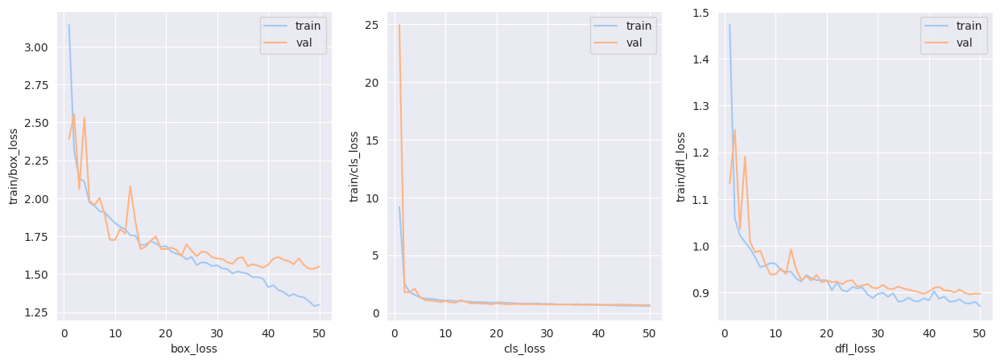

In [ ]:
#Plotting the losses
plt.figure(figsize=(15,5))
k=1
for i in ['box_loss','cls_loss','dfl_loss']:
    ax=plt.subplot(1,3,k)
    sns.lineplot(df_result,x='epoch',y='train/'+i,label='train',ax=ax)
    sns.lineplot(df_result,x='epoch',y='val/'+i,label='val',ax=ax)
    ax.set_xlabel(i)
    k+=1


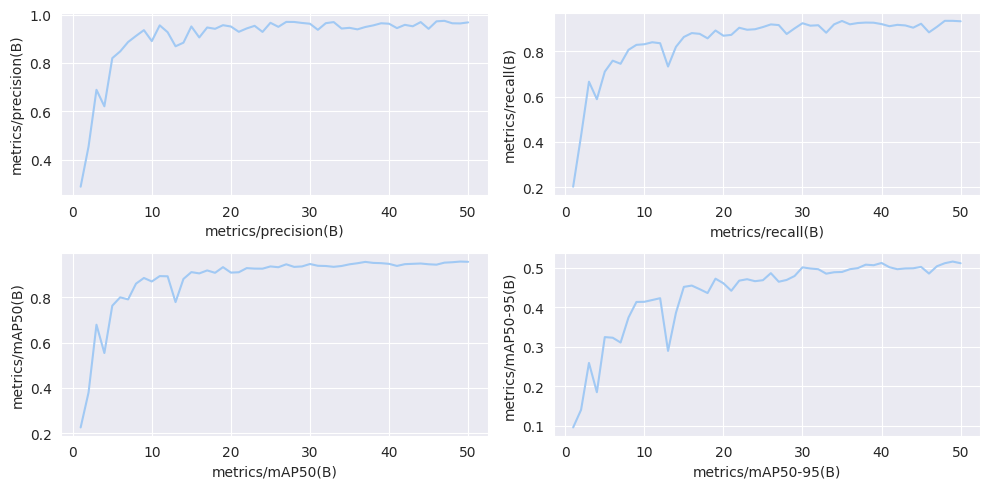

In [ ]:
#Plotting the metrics
plt.figure(figsize=(10,5))
k=1
for i in ['metrics/precision(B)','metrics/recall(B)','metrics/mAP50(B)','metrics/mAP50-95(B)']:
    ax=plt.subplot(2,2,k)
    sns.lineplot(df_result,x='epoch',y=i,ax=ax)
    ax.set_xlabel(i)
    k+=1
plt.tight_layout()

In [ ]:
#Creating function to visualize result:
def visualize_result(dir_name,list_images):
    k=1
    plt.figure(figsize=(20,15))
    for filename in list_images:
            ax=plt.subplot((len(list_images)//2+1),2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()


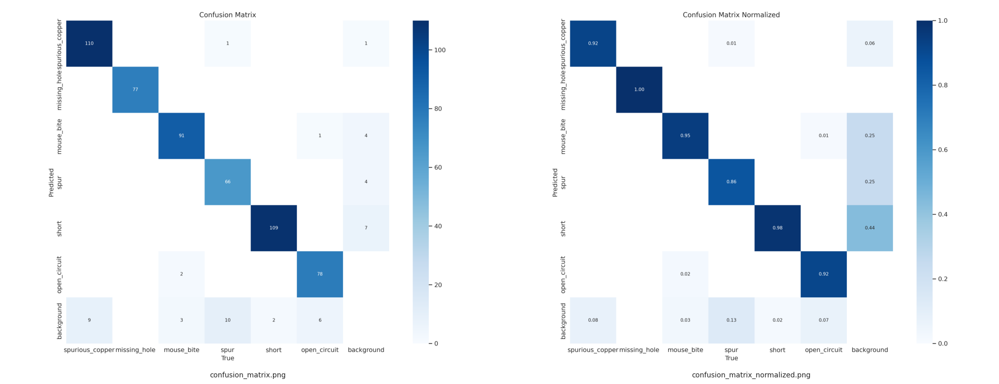

In [ ]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_dir,list_confusion)

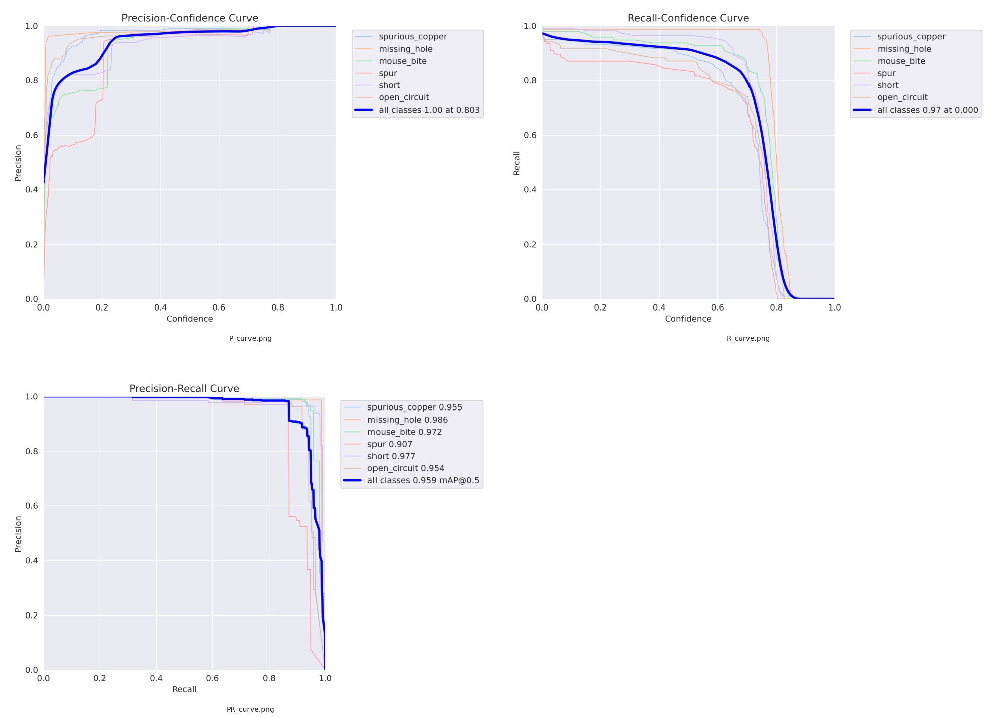

In [ ]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_dir,list_curve)

**Mean Average Precision on validation set at 0.5 threshold=0.968**

# **Evaluating on val & Test Data**

In [ ]:
#Now let's load our best model to evaluate
os.listdir(os.path.join(result_dir,'weights'))
best_model_path=os.path.join(result_dir,'weights','last.pt')
best_model=YOLO(best_model_path)

In [ ]:
#Defing a function to view prediction against actual  along with bounding box

def draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,annotation_actual,annotation_predict):


    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    for bbox in bounding_boxes_actual:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_actual,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

     # Draw each bounding box for predicted
    for bbox in bounding_boxes_predict:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='yellow', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_predict,(centroid_x,centroid_y),(min_x-20,min_y-20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [ ]:
#Defining the function to predict and return annoted image
def model_predict_compare(model,image_path,df_annot):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes_predict=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes

            annotation_predict=class_dict[pred_class]
        else:
            bounding_boxes_predict=[]
            annotation_predict=''


    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    df_selected=df_annot[df_annot['filename']==filename]

    xmin=df_selected['xmin'].values
    ymin=df_selected['ymin'].values
    xmax=df_selected['xmax'].values
    ymax=df_selected['ymax'].values

    annotation_actual=str(df_selected['class'].values[0])

    bounding_boxes_actual=zip(xmin,ymin,xmax,ymax)

    draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,'actual_'+annotation_actual,'predicted_'+annotation_predict)




image 1/1 /content/dataset/images/val/04_short_12.jpg: 544x640 3 shorts, 48.1ms
Speed: 6.9ms preprocess, 48.1ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 640)


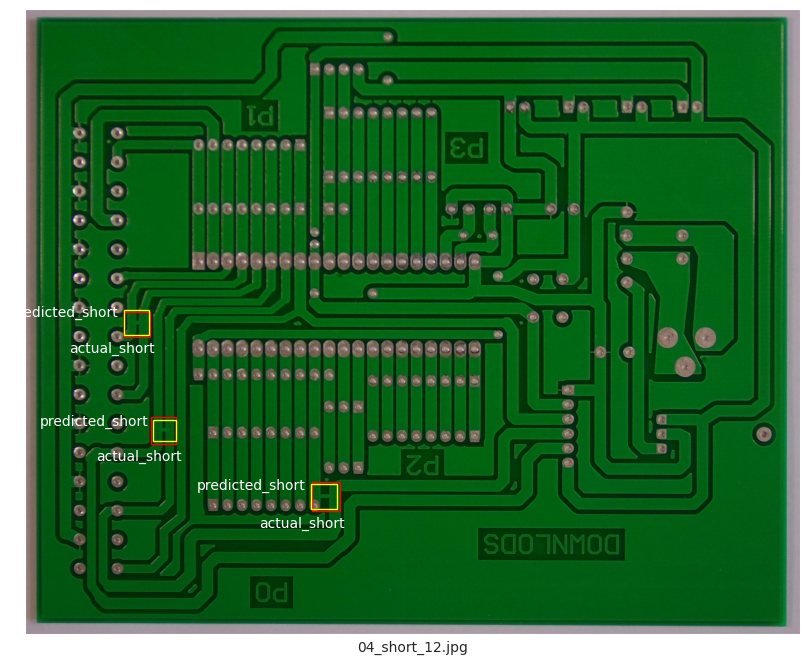


image 1/1 /content/dataset/images/val/06_mouse_bite_09.jpg: 544x640 4 mouse_bites, 35.4ms
Speed: 4.8ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


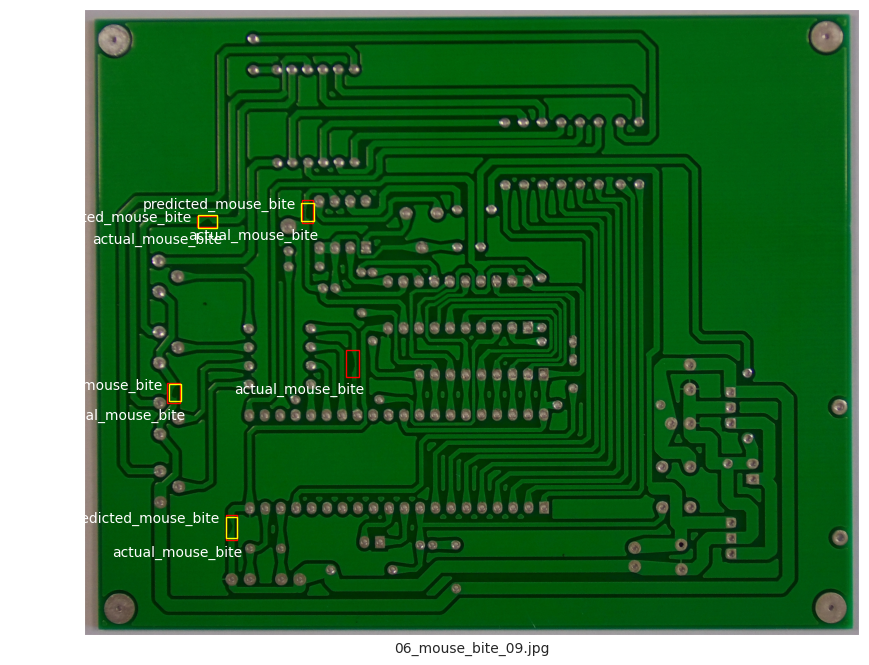


image 1/1 /content/dataset/images/val/04_short_01.jpg: 544x640 1 short, 35.3ms
Speed: 4.6ms preprocess, 35.3ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


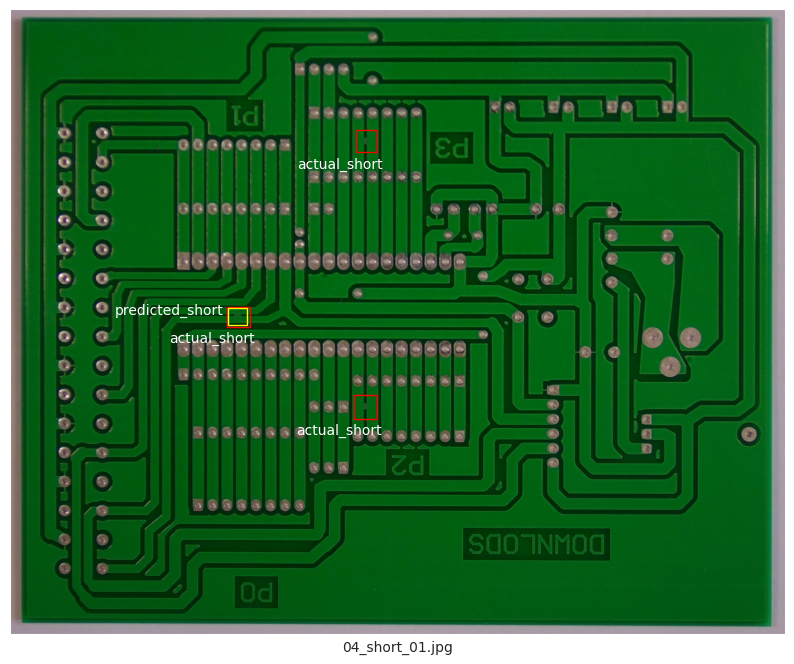


image 1/1 /content/dataset/images/val/09_mouse_bite_10.jpg: 512x640 5 mouse_bites, 70.1ms
Speed: 4.7ms preprocess, 70.1ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


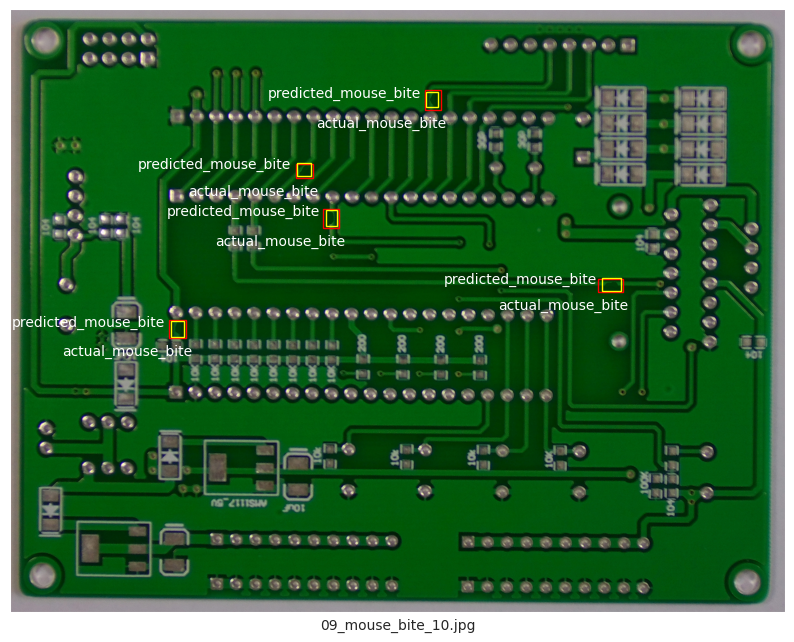


image 1/1 /content/dataset/images/val/01_open_circuit_13.jpg: 352x640 2 open_circuits, 99.5ms
Speed: 3.4ms preprocess, 99.5ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)


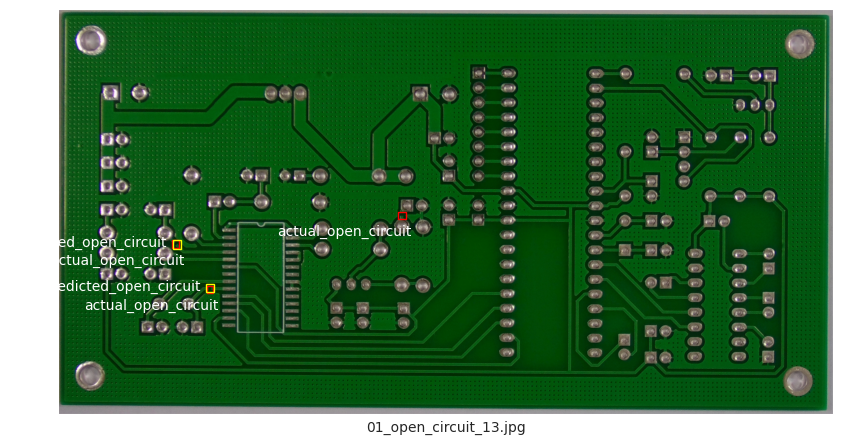

In [ ]:
#Predicting on val data for 5 val images
val_image_dir=os.path.join(images_dir,'val')
for i in os.listdir(val_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(val_image_dir,i),df_annot)


image 1/1 /content/dataset/images/test/10_short_04.jpg: 576x640 5 shorts, 58.1ms
Speed: 5.1ms preprocess, 58.1ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)


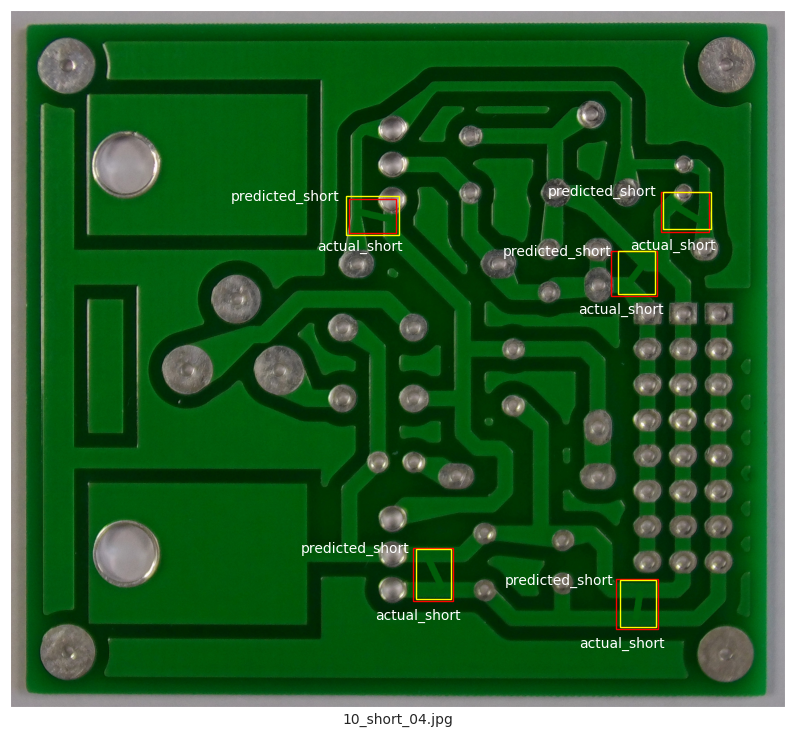


image 1/1 /content/dataset/images/test/04_missing_hole_11.jpg: 544x640 3 missing_holes, 41.0ms
Speed: 5.2ms preprocess, 41.0ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


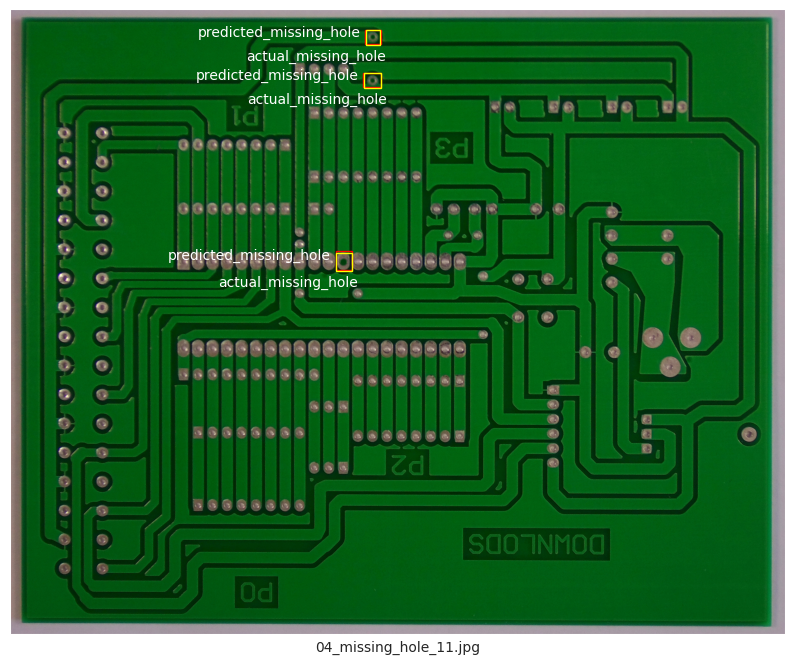


image 1/1 /content/dataset/images/test/12_mouse_bite_02.jpg: 640x640 5 mouse_bites, 40.5ms
Speed: 5.7ms preprocess, 40.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


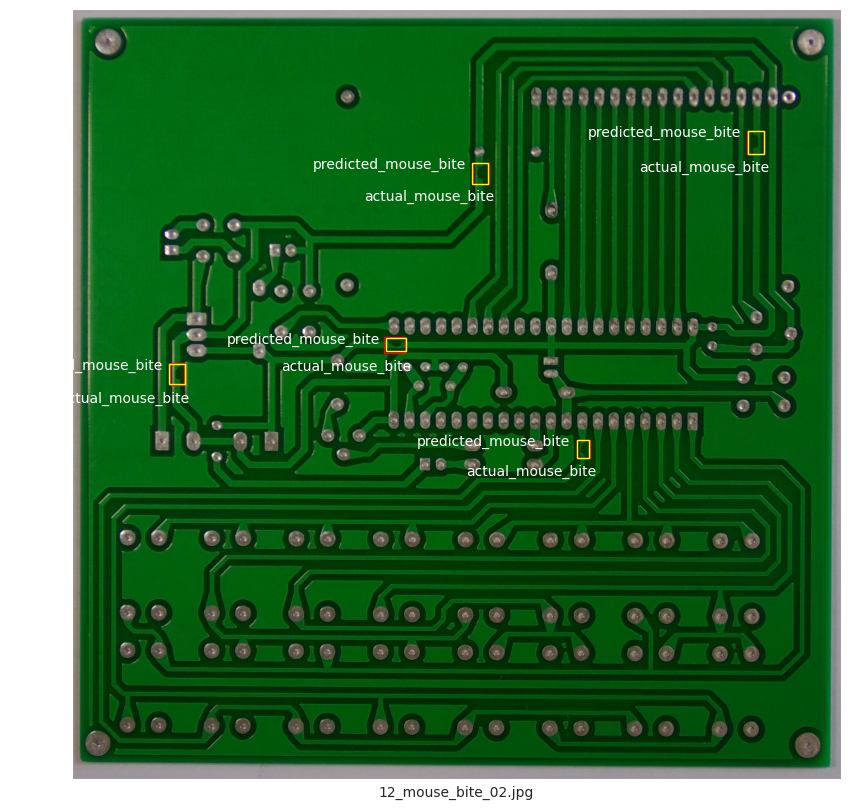


image 1/1 /content/dataset/images/test/07_spurious_copper_03.jpg: 448x640 5 spurious_coppers, 74.8ms
Speed: 4.2ms preprocess, 74.8ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


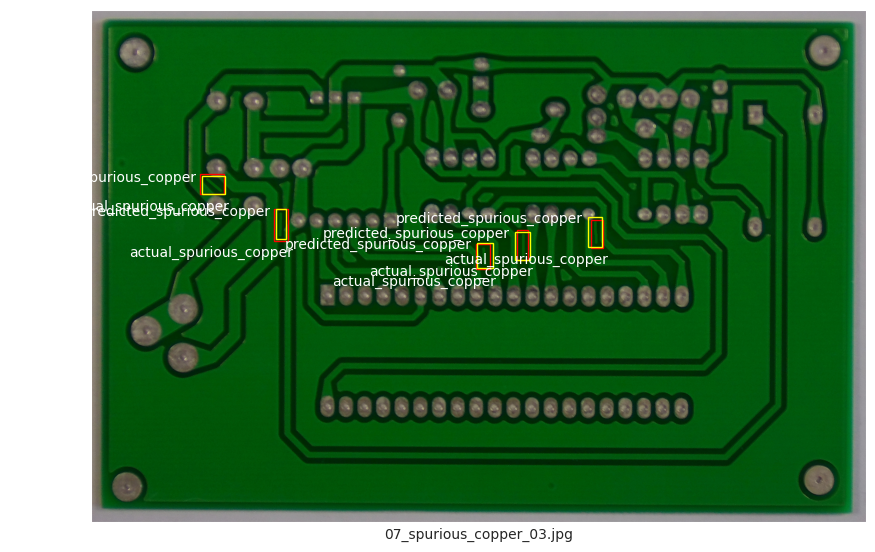


image 1/1 /content/dataset/images/test/08_open_circuit_06.jpg: 512x640 5 open_circuits, 35.8ms
Speed: 4.9ms preprocess, 35.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


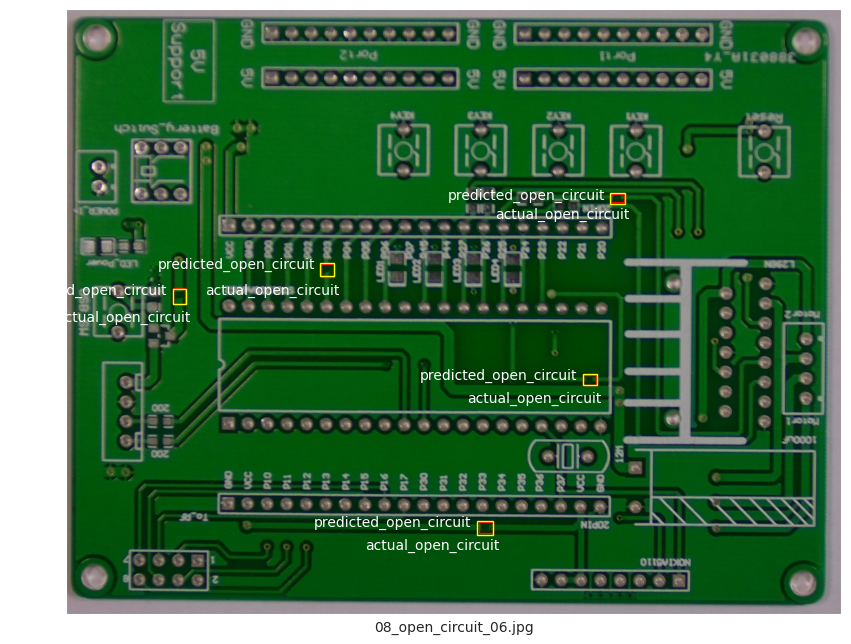

In [ ]:
#Predicting on test data for 5 test images
test_image_dir=os.path.join(images_dir,'test')
for i in os.listdir(test_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(test_image_dir,i),df_annot)

Generating metrics for test dataset by using the test dataset as val dataset and predicting

In [ ]:
def move_to_dummy(original_dir,dummy_dir):
    if os.path.exists(dummy_dir):
        shutil.rmtree(dummy_dir) #Remove if exists
    os.makedirs(dummy_dir)

    images_dum_val_dir=os.path.join(dummy_dir,'images','val')
    labels_dum_val_dir=os.path.join(dummy_dir,'labels','val')
    images_dum_train_dir=os.path.join(dummy_dir,'images','train')
    labels_dum_train_dir=os.path.join(dummy_dir,'labels','train')

    os.makedirs(images_dum_val_dir)
    os.makedirs(labels_dum_val_dir)
    os.makedirs(images_dum_train_dir)
    os.makedirs(labels_dum_train_dir)

    images_test_dir=os.path.join(original_dir,'images','test')
    labels_test_dir=os.path.join(original_dir,'labels','test')
    images_train_dir=os.path.join(original_dir,'images','train')
    labels_train_dir=os.path.join(original_dir,'labels','train')

    for i in os.listdir(images_test_dir):
        shutil.copy(os.path.join(images_test_dir,i),os.path.join(images_dum_val_dir,i))
    for i in os.listdir(labels_test_dir):
        shutil.copy(os.path.join(labels_test_dir,i),os.path.join(labels_dum_val_dir,i))
    for i in os.listdir(images_train_dir):
        shutil.copy(os.path.join(images_train_dir,i),os.path.join(images_dum_train_dir,i))
    for i in os.listdir(labels_train_dir):
        shutil.copy(os.path.join(labels_train_dir,i),os.path.join(labels_dum_train_dir,i))

In [ ]:
original_dir=os.path.join(root_dir,'dataset')
dummy_dir=os.path.join(root_dir,'dummy_dataset')

move_to_dummy(original_dir,dummy_dir)

print(f"Length of image files:{len(os.listdir(os.path.join(dummy_dir,'images','val')))}")
print(f"Length of label files:{len(os.listdir(os.path.join(dummy_dir,'labels','val')))}")

Creating yaml file

In [ ]:
#Creating YAML format
data_test_yaml={
    'path':str(os.path.join(root_dir,'dummy_dataset')),
    'train':'images/train',
    'val':'images/val',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_test_yaml

In [ ]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data_test.yaml', 'w') as f:
    yaml.dump(data_test_yaml, f, default_flow_style=False)

In [ ]:
result_val=best_model.val(data=os.path.join(root_dir,'data_test.yaml'))

In [ ]:
result_val_dir='runs/detect/val2'

In [ ]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_val_dir,list_confusion)

In [ ]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_val_dir,list_curve)

**Mean Average Precision on test set at 0.5 threshold=0.987**

# **Creating a function to predict & return annoted image**

In [ ]:
#Defing a function to view image along with bounding box

def draw_bounding_boxes_image(image_path, bounding_boxes,annotation):


    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    if len(bounding_boxes)==0:
        plt.text(0.5, 0.5, 'No defects detected',
                 horizontalalignment='center',verticalalignment='center',color='white',fontsize=16)

    else:
        for bbox in bounding_boxes:
            min_x, min_y, max_x, max_y = bbox
            width = max_x - min_x
            height = max_y - min_y
            rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

            # Calculate the centroid of the bounding box
            centroid_x = (min_x + max_x) / 2
            centroid_y = (min_y + max_y) / 2

            # Add the annotation to the centroid
            ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
                fontsize=10,color='white',
                horizontalalignment='right', verticalalignment='top')


    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [ ]:
#Defining the function to predict and return annoted image
def model_predict(model,image_path):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes
            annotation=class_dict[pred_class]
        else:
            bounding_boxes=[]
            annotation=''



    draw_bounding_boxes_image(image_path, bounding_boxes,annotation)




In [ ]:
#Testing on sample data
for i in os.listdir(os.path.join(dummy_dir,'images','val'))[0:10:2]:
    image_path=os.path.join(dummy_dir,'images','val',i)
    model_predict(model=best_model,image_path=image_path)

Saving the model as pkl file for further use

In [ ]:
import joblib

In [ ]:
#saving model as pkl file
if os.path.exists(os.path.join(root_dir,'yolo_model.pkl')):
    os.remove(os.path.join(root_dir,'yolo_model.pkl'))

with open('yolo_model.pkl','wb') as f:
    joblib.dump(best_model,f)

In [ ]:
with open('yolo_model.pkl','rb') as f:
    bmodel=joblib.load(f)

# Summary

Hence we achieved around 98% Mean Avearge Precision score on PCB Defect detection task using pre-trained YOLO11 dataset from Ultralytics, and used that to create a model to predict and visualize various type of defect.